 **CDA Block 4 Project Assignment**


**Instructions**

**Make a copy of this notebook.**

**Rename the notebook to *your_name - Block 4 Assignment.ipynb*.**


##Introduction

We will be looking at the sales of a bicycle company. The data spans across sales, customer demographics and products. The datasets are just a small part of a much larger database. 

Such datasets are very common in a business setting, where different information are kept in different tables and connected via one or two variables (foreign keys).

The business objectives for this assignment are

1. Understanding more about the customers and their spending habits
2. Which group of customers to target
3. Predicting the lifetime value of each customer





### About the datasets

The file **aw_bicycle.xlsx** (in Block 4 data folder) contains a few sheets:

* **Sales Customer**: connecting file between customer and sales
* **Sales SalesOrderHeader**: information regarding sales orders (order/invoice level)
* **Sales SalesOrderDetail**: information regarding each sales item (itemized level)
* **Sales vPersonDemographics**: customer attributes (e.g. birthday, marital status, gender, etc.)
* **Production Product**: product name and attributes



To connect the datasets, here are the key columns/variables:

* **Sales Customer** to **Sales SalesOrderHeader**: *CustomerID*
* **Sales Customer** to **Sales vPersonDemographics**: *PersonID* to *BusinessEntityID*
* **Sales SalesOrderHeader** to **Sales SalesOrderDetail**: *SalesOrderID*
* **Sales SalesOrderDetail** to **Production Product**: *ProductID*



###**To do**

####RFM Clustering Analysis

1.   Connect the **SalesOrderDetail** to **SalesOrderHeader** such that you can perform a Recency, Frequency, Monetary analysis
  * **Recency**: Use the latest *OrderDate* as the benchmark to measure the number of days a customer (*CustomerID*) last purchased.
  * **Frequency**: Count the number of *SalesOrderID* at the detailed item level per customer.
  * **Monetary**: Sum the total of *LineTotal* (Quantity * Unit Price) at the detailed item level per customer.
  * Combine all 3 metrics at the customer level (each row is one unique customer).
  * Remove outliers if you need (trim by 1st and 99th percentile).

2. Perform a clustering (kmeans) analysis on the **RFM** dataset.
  * How many number of clusters did you choose and why?
  * Which group of customers are important in terms of RFM?
    * Is there enough customers in this group? If not, which other group should you focus your attention on?
  * Which group of customers you should ignore?

####Customer Lifetime Value Prediction

There are many definitions of lifetime value of a customer. The general idea is the **average spending of a customer** mulitipled by the **time they spend at your business**.

1. We will define lifetime value of a customer by using our RFM dataset (at per customer level).
  * Find the *average_spend_value* (average Spend value per customer) by taking *monetary* / *frequency*
  * Define *max_no_days* (maximum number of days) by the total length of days in the dataset (max - min *OrderDate*).
  * Define the *years_of_service* to each customer by taking (*max_no_days* - *recency*) / 365.
  * Define *lifetime_value* by multiplying *average_spend_value* by *years_of_service*.

2. We need some demographics of customers to help us predict what are the important factors that can help us predict the lifetime value. 
  * Connect the **RFM** dataset to **Sales vPersonDemographics** via **SalesCustomer**. Be sure to remove any NA records. 
  * Run a prediction model (Regression or Classification)
    * Target variable: *lifetime_value*.
    * Compare and select the best model based on minimum MAPE (Regression) or maximum F1 (Classification).
    * Explore the important features of the best model, and extract the demographics of the customers based on the important features. What can be said regarding such customers?
    * Optional: Plot and compare the customers between different groups
    * Optional: What are the kind of products the customers bought? Have to connect to **Production Product** dataset. 



##Setup

In [ ]:
# Mount Google drive
# Mount Google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# install packages that are not default in colab
!pip3 install pycaret
!pip3 install shap
!pip3 install -I pandas-profiling

# swifter package helps us apply function to pd dataframes much faster
# but swifter is not included in colab
# we have to install it
# souce: https://github.com/jmcarpenter2/swifter
!pip3 install swifter
!pip install Jinja2
!pip install markupsafe==2.0.1
!pip install pyyaml==5.4.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 320 kB 8.3 MB/s 
     |████████████████████████████████| 56 kB 5.8 MB/s 
     |████████████████████████████████| 88 kB 8.8 MB/s 
     |████████████████████████████████| 17.9 MB 540 kB/s 
     |████████████████████████████████| 262 kB 59.0 MB/s 
     |████████████████████████████████| 134 kB 63.2 MB/s 
     |████████████████████████████████| 25.9 MB 1.2 MB/s 
     |████████████████████████████████| 1.7 MB 49.7 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 3.3 MB 43.4 MB/s 
     |████████████████████████████████| 1.3 MB 60.6 MB/s 
     |████████████████████████████████| 2.0 MB 52.4 MB/s 
     |████████████████████████████████| 6.8 MB 54.0 MB/s 
     |████████████████████████████████| 1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 569 kB 6.9 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached pandas_profiling-3.2.0-py2.py3-none-any.whl (262 kB)
  Using cached MarkupSafe-2.1.1-cp37-cp37m-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (25 kB)
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
     |████████████████████████████████| 78 kB 8.8 MB/s 
  Using cached visions-0.7.4-py3-none-any.whl (102 kB)
  Using cached multimethod-1.8-py3-none-any.whl (9.8 kB)
     |████████████████████████████████| 596 kB 54.9 MB/s 
     |████████████████████████████████| 11.2 MB 42.4 MB/s 
     |████████████████████████████████| 292 kB 72.5 MB/s 
     |████████████████████████████████| 11.1 MB 47.7 MB/s 
     |████████████████████████████████| 306 kB 53.6 MB/s 
  Using cached requests-2.28.1-py3-none-any.whl (62 kB)
  Usi

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 821 kB 7.7 MB/s 
     |████████████████████████████████| 281 kB 65.2 MB/s 
     |████████████████████████████████| 141 kB 77.1 MB/s 
  Created wheel for swifter: filename=swifter-1.3.3-py3-none-any.whl size=16253 sha256=ff15b206effc4969d9eea756b00eb161264c617add1851a5c9e4d851b8500711
  Stored in directory: /root/.cache/pip/wheels/64/bf/da/da0022edab5fd84114858a95e4f32f2fca0d5b7d758905f594
Successfully built swifter
  Attempting uninstall: psutil
    Found existing installation: psutil 5.4.8
    Uninstalling psutil-5.4.8:
      Successfully uninstalled psutil-5.4.8


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Attempting uninstall: markupsafe
    Found existing installation: MarkupSafe 2.1.1
    Uninstalling MarkupSafe-2.1.1:
      Successfully uninstalled MarkupSafe-2.1.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pandas-profiling 3.2.0 requires markupsafe~=2.1.1, but you have markupsafe 2.0.1 which is incompatible.
flask 1.1.4 requires Jinja2<3.0,>=2.10.1, but you have jinja2 3.1.2 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached PyYAML-5.4.1-cp37-cp37m-manylinux1_x86_64.whl (636 kB)
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyY

In [ ]:
#import libraries needed
import os
import swifter
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import jinja2

# Visualization setting
%matplotlib inline
sns.set_style('darkgrid')


##read files

In [ ]:
# define folder path
folder_path = "/content/drive/MyDrive/cda_data/PBID"
file_path = os.path.join(folder_path, "aw_bicycle.xlsx")


In [ ]:
# read in excel file
# https://pandas.pydata.org/docs/reference/api/pandas.read_excel.html

# read sales customer dataframe

df_sales_customer = pd.read_excel(file_path, sheet_name = "Sales Customer")
df_sales_customer.head()

,CustomerID,PersonID,StoreID,TerritoryID,AccountNumber,rowguid,ModifiedDate
0,11015,10963.0,NaN,4,AW00011015,F791BD74-EB82-4631-B9FC-F9FEE621FD13,2014-09-12 11:15:07
1,11016,3800.0,NaN,4,AW00011016,023843CA-25FB-42BF-AC37-FAF6F4120DAC,2014-09-12 11:15:07
2,11023,4373.0,NaN,4,AW00011023,A2833BD8-44A8-4665-808E-33E19ECD7F54,2014-09-12 11:15:07
3,11024,16843.0,NaN,4,AW00011024,EE8EEBF8-117C-4027-873D-6113B0E97489,2014-09-12 11:15:07
4,11036,20539.0,NaN,4,AW00011036,2E40BEAF-4A55-4E4D-A87D-009CC27D4378,2014-09-12 11:15:07


In [ ]:
# read sales order header
df_sales_order_header = pd.read_excel(file_path, sheet_name="Sales SalesOrderHeader")
df_sales_order_header.head()

,SalesOrderID,RevisionNumber,OrderDate,DueDate,ShipDate,Status,OnlineOrderFlag,SalesOrderNumber,PurchaseOrderNumber,AccountNumber,...,CreditCardID,CreditCardApprovalCode,CurrencyRateID,SubTotal,TaxAmt,Freight,TotalDue,Comment,rowguid,ModifiedDate
0,43702,8,2011-06-01,2011-06-13,2011-06-16,5,True,SO43702,NaN,10-4030-027645,...,8087.0,1230194Vi41919,NaN,3578.27,286.2616,89.4568,3953.9884,NaN,9310C7F0-9A84-4CE9-BE08-F700FB1AADF7,2011-06-08
1,43706,8,2011-06-02,2011-06-14,2011-06-06,5,True,SO43706,NaN,10-4030-027621,...,10912.0,230189Vi56258,NaN,3578.27,286.2616,89.4568,3953.9884,NaN,F02C4CB6-A5B5-4CE4-9473-CB084E383196,2011-06-09
2,43707,8,2011-06-02,2011-06-14,2011-06-11,5,True,SO43707,NaN,10-4030-027616,...,19069.0,230298Vi99064,NaN,3578.27,286.2616,89.4568,3953.9884,NaN,0DA77D6E-223E-4BC6-A2ED-43B387692C68,2011-06-09
3,43713,8,2011-06-04,2011-06-16,2011-06-11,5,True,SO43713,NaN,10-4030-027601,...,16570.0,830288Vi85808,NaN,3578.27,286.2616,89.4568,3953.9884,NaN,9DE30294-9066-4988-A3AD-09A0713348E5,2011-06-11
4,43719,8,2011-06-05,2011-06-17,2011-06-24,5,True,SO43719,NaN,10-4030-027612,...,5998.0,1130295Vi31203,NaN,3578.27,286.2616,89.4568,3953.9884,NaN,BF5155EB-C5BE-4245-8FC4-F801DB5B052D,2011-06-12


In [ ]:
# read sales order details
df_sales_order_details = pd.read_excel(file_path, sheet_name = "Sales SalesOrderDetail")
df_sales_order_details.head(2)

,SalesOrderID,SalesOrderDetailID,CarrierTrackingNumber,OrderQty,ProductID,SpecialOfferID,UnitPrice,UnitPriceDiscount,LineTotal,rowguid,ModifiedDate
0,51178,37753,NaN,1,870,1,4.99,0.0,4.99,EA75710F-2568-42FF-B92B-1518FE295200,2013-05-30
1,51180,37760,NaN,1,870,1,4.99,0.0,4.99,48A11063-A834-497E-B52B-82EE30589F4C,2013-05-30


In [ ]:
# read in product file
df_production_product = pd.read_excel(file_path, sheet_name="Production Product")
df_production_product.head(2)

,ProductID,Name,ProductNumber,MakeFlag,FinishedGoodsFlag,Color,SafetyStockLevel,ReorderPoint,StandardCost,ListPrice,...,ProductLine,Class,Style,ProductSubcategoryID,ProductModelID,SellStartDate,SellEndDate,DiscontinuedDate,rowguid,ModifiedDate
0,1,Adjustable Race,AR-5381,False,False,NaN,1000,750,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,2008-04-30,NaT,NaN,694215B7-08F7-4C0D-ACB1-D734BA44C0C8,2014-02-08 10:01:36.827
1,2,Bearing Ball,BA-8327,False,False,NaN,1000,750,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,2008-04-30,NaT,NaN,58AE3C20-4F3A-4749-A7D4-D568806CC537,2014-02-08 10:01:36.827


In [ ]:
# read in demographics file
df_demographics = pd.read_excel(file_path, sheet_name="Sales vPersonDemographics")
df_demographics.head(2)


,BusinessEntityID,TotalPurchaseYTD,DateFirstPurchase,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned
0,3058,19.20,2004-04-07,1979-05-07,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0
1,3246,557.49,2003-10-24,1975-11-07,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0


##merge and explore transaction data

In [ ]:
# merge product and sales detail file (main)
df_detail_prod = df_sales_order_details.merge(df_production_product, 
                                           how='left', 
                                           on='ProductID', 
                                           suffixes=['_sales_det','_prod'])
df_detail_prod.head(2)

,SalesOrderID,SalesOrderDetailID,CarrierTrackingNumber,OrderQty,ProductID,SpecialOfferID,UnitPrice,UnitPriceDiscount,LineTotal,rowguid_sales_det,...,ProductLine,Class,Style,ProductSubcategoryID,ProductModelID,SellStartDate,SellEndDate,DiscontinuedDate,rowguid_prod,ModifiedDate_prod
0,51178,37753,NaN,1,870,1,4.99,0.0,4.99,EA75710F-2568-42FF-B92B-1518FE295200,...,S,NaN,NaN,28.0,111.0,2013-05-30,NaT,NaN,834E8D1A-69A7-4C42-8B68-FA08D9EC9E5B,2014-02-08 10:01:36.827
1,51180,37760,NaN,1,870,1,4.99,0.0,4.99,48A11063-A834-497E-B52B-82EE30589F4C,...,S,NaN,NaN,28.0,111.0,2013-05-30,NaT,NaN,834E8D1A-69A7-4C42-8B68-FA08D9EC9E5B,2014-02-08 10:01:36.827


In [ ]:
# merge sales order header and details (main)
df_sales_order = pd.merge(left=df_detail_prod, 
                        right=df_sales_order_header, 
                        how='left', 
                        on='SalesOrderID', 
                        suffixes=['_sales_det','_sales_head'])
df_sales_order.head()



,SalesOrderID,SalesOrderDetailID,CarrierTrackingNumber,OrderQty,ProductID,SpecialOfferID,UnitPrice,UnitPriceDiscount,LineTotal,rowguid_sales_det,...,CreditCardID,CreditCardApprovalCode,CurrencyRateID,SubTotal,TaxAmt,Freight,TotalDue,Comment,rowguid,ModifiedDate
0,51178,37753,NaN,1,870,1,4.99,0.0,4.99,EA75710F-2568-42FF-B92B-1518FE295200,...,3760.0,216547Vi19810,NaN,2334.97,186.7976,58.3743,2580.1419,NaN,968B58F6-8CA8-4163-B3E0-14C386E8DFD6,2013-06-06
1,51180,37760,NaN,1,870,1,4.99,0.0,4.99,48A11063-A834-497E-B52B-82EE30589F4C,...,16046.0,820164Vi82960,NaN,2542.31,203.3848,63.5578,2809.2526,NaN,7FFE4ECC-5FFA-4EFC-BEDE-F338CD35E2F1,2013-06-06
2,51191,37790,NaN,1,870,1,4.99,0.0,4.99,FC5AE823-6DB6-46F1-938C-C964060DBF0D,...,2365.0,719210Vi12295,NaN,2344.96,187.5968,58.6240,2591.1808,NaN,96EFBBA5-0145-4025-8F9F-0EED56CA7B08,2013-06-07
3,51196,37804,NaN,1,870,1,4.99,0.0,4.99,EC5E95F4-4410-4872-9166-364E2C60C878,...,5728.0,439136Vi29988,8411.0,638.95,51.1160,15.9738,706.0398,NaN,6E5983D9-21CF-4500-A5BF-BB14656959F4,2013-06-07
4,51197,37809,NaN,1,870,1,4.99,0.0,4.99,6E7DDB1D-BAF3-4F44-9B1B-6BCFE86ECD22,...,10041.0,639470Vi51713,8411.0,2318.96,185.5168,57.9740,2562.4508,NaN,6067B94A-80CC-43CC-A038-1DCA9C3E3374,2013-06-07


In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
# run pandas profiling to take a look at the sales order header and detailed data
report = ProfileReport(df_sales_order,html={'style':{'full_width':True}}) 
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
report.to_file('profile_report.html')

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

##calculate recency, freqency, monetary

In [ ]:

df_sales_order.drop(['TerritoryID', 'RevisionNumber','CarrierTrackingNumber','SalesOrderDetailID','Name','Color','Size','WeightUnitMeasureCode','Weight','DaysToManufacture','ProductLine','Class','Style','ProductSubcategoryID','ProductModelID','SellStartDate','SellEndDate','rowguid_prod','ProductNumber','MakeFlag','rowguid_sales_det','ProductID','UnitPriceDiscount','SpecialOfferID','DueDate','ShipDate','BillToAddressID','SalesPersonID', 'ShipToAddressID','SalesOrderNumber','Status','PurchaseOrderNumber','AccountNumber','CurrencyRateID','Comment','rowguid','OnlineOrderFlag','ShipMethodID','CreditCardID', 'CreditCardApprovalCode'], axis=1, inplace=True)
df_sales_order.head()

,SalesOrderID,OrderQty,UnitPrice,LineTotal,ModifiedDate_sales_det,FinishedGoodsFlag,SafetyStockLevel,ReorderPoint,StandardCost,ListPrice,SizeUnitMeasureCode,DiscontinuedDate,ModifiedDate_prod,OrderDate,CustomerID,SubTotal,TaxAmt,Freight,TotalDue,ModifiedDate
0,51178,1,4.99,4.99,2013-05-30,True,4,3,1.8663,4.99,NaN,NaN,2014-02-08 10:01:36.827,2013-05-30,11245,2334.97,186.7976,58.3743,2580.1419,2013-06-06
1,51180,1,4.99,4.99,2013-05-30,True,4,3,1.8663,4.99,NaN,NaN,2014-02-08 10:01:36.827,2013-05-30,16313,2542.31,203.3848,63.5578,2809.2526,2013-06-06
2,51191,1,4.99,4.99,2013-05-31,True,4,3,1.8663,4.99,NaN,NaN,2014-02-08 10:01:36.827,2013-05-31,12390,2344.96,187.5968,58.6240,2591.1808,2013-06-07
3,51196,1,4.99,4.99,2013-05-31,True,4,3,1.8663,4.99,NaN,NaN,2014-02-08 10:01:36.827,2013-05-31,18906,638.95,51.1160,15.9738,706.0398,2013-06-07
4,51197,1,4.99,4.99,2013-05-31,True,4,3,1.8663,4.99,NaN,NaN,2014-02-08 10:01:36.827,2013-05-31,11448,2318.96,185.5168,57.9740,2562.4508,2013-06-07


In [ ]:
#### create recency variable
# based on latest OrderDate as days = 0 (max OrderDate - current line OrderDate)
# grouped by CustomerID
# set the index as CustomerID
# recency variable will be timedelta datatype, convert to integer using dt.days() 
df_sales_order['recency'] = max(df_sales_order.OrderDate) - df_sales_order.OrderDate
df_sales_order.sort_values('recency', ascending=True)
rfm_r = df_sales_order.groupby('CustomerID')['recency'].min()
rfm_r = rfm_r.reset_index().set_index('CustomerID')
rfm_r['recency'] = rfm_r.recency.dt.days
rfm_r

,recency
CustomerID,
11000,270
11001,49
11002,339
11003,263
11004,272
...,...
30114,121
30115,91
30116,121


In [ ]:
#### create frequency variable
# count the number of SalesOrderID, grouped by CustomerID (make sure it's sales detailed item level)
# set the index as CustomerID
# rename column name to 'frequency'
rfm_f = df_sales_order.groupby('CustomerID')['SalesOrderID'].count()
rfm_f = rfm_f.reset_index().set_index('CustomerID')
rfm_f.rename({'SalesOrderID': 'frequency'}, axis=1, inplace=True)
rfm_f

,frequency
CustomerID,
11000,8
11001,11
11002,4
11003,9
11004,6
...,...
30114,30
30115,21
30116,119


In [ ]:
#### create monetary variable
# use LineTotal as already quantity * unit_price
# LineTotal is the total amount for each line item
# sum LineTotal, groupby CustomerID
# set the index as CustomerID
# rename column name to 'monetary'
df_sales_order['monetary'] = df_sales_order.LineTotal
rfm_m = df_sales_order.groupby('CustomerID')['monetary'].sum()
rfm_m = rfm_m.reset_index().set_index('CustomerID')
rfm_m

,monetary
CustomerID,
11000,8248.990000
11001,6383.880000
11002,8114.040000
11003,8139.290000
11004,8196.010000
...,...
30114,11652.991100
30115,8917.559400
30116,187114.201050


In [ ]:
# combine recency, frequency, monetary datasets together
# makign sure there are no missing values
# CustomerID should be the index, 'recency', 'frequency, 'monetary' should be the columns
rfm = pd.concat([rfm_r, rfm_f, rfm_m], axis=1, join='inner')
rfm

,recency,frequency,monetary
CustomerID,,,
11000,270,8,8248.990000
11001,49,11,6383.880000
11002,339,4,8114.040000
11003,263,9,8139.290000
11004,272,6,8196.010000
...,...,...,...
30114,121,30,11652.991100
30115,91,21,8917.559400
30116,121,119,187114.201050


In [ ]:
rfm.describe()

,recency,frequency,monetary
count,19119.000000,19119.000000,19119.000000
mean,190.267483,6.345363,5745.404122
std,150.423605,26.478444,38800.383347
min,0.000000,1.000000,1.374000
25%,85.000000,2.000000,54.980000
50%,165.000000,3.000000,548.980000
75%,263.000000,4.000000,2822.386050
max,1126.000000,530.000000,877107.192221


/usr/local/lib/python3.7/dist-packages/seaborn/_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


<AxesSubplot:xlabel='monetary'>

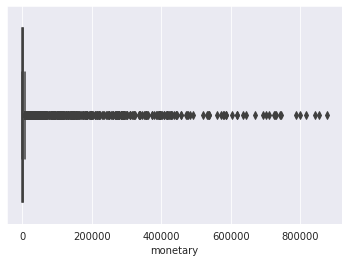

In [ ]:
# checking outliers on 'monetary' column
# plot boxplot of 'monetary'
sns.boxplot('monetary', orient='v', data=rfm)


##remove outliers by monetary

In [ ]:
#### removing outliers 
# trim the dataset at 1 percentile and 99th percentile
# which means removing records below 1st percentile and above 99th percentile
# first, establish the 1st and 99th percentile

# Check the descriptive statistics to see if the numbers are better (especially monetary)
p1 = rfm.monetary.quantile(0.01)
p99 = rfm.monetary.quantile(0.99)
rfm[(rfm.monetary >= p1) & (rfm.monetary <= p99)].describe()


,recency,frequency,monetary
count,18851.000000,18851.000000,18851.000000
mean,190.459339,4.106838,2366.388156
std,149.985116,8.686692,8216.586379
min,0.000000,1.000000,4.990000
25%,85.000000,2.000000,54.980000
50%,166.000000,3.000000,548.980000
75%,264.000000,4.000000,2751.417500
max,1126.000000,181.000000,144602.581600


In [ ]:
# apply the changes to remove records below and above 99th percentile
rfm = rfm[(rfm.monetary >= p1) & (rfm.monetary <= p99)]
rfm

,recency,frequency,monetary
CustomerID,,,
11000,270,8,8248.9900
11001,49,11,6383.8800
11002,339,4,8114.0400
11003,263,9,8139.2900
11004,272,6,8196.0100
...,...,...,...
30106,426,114,101203.5836
30108,457,105,144602.5816
30110,426,6,1625.2755


In [ ]:
rfm.sort_values('monetary', ascending=True).head(10)

,recency,frequency,monetary
CustomerID,,,
15560,262,1,4.99
26176,118,1,4.99
26173,273,1,4.99
21869,58,1,4.99
16966,42,1,4.99
16978,322,1,4.99
16988,58,1,4.99
16992,303,1,4.99
17014,351,1,4.99


In [ ]:
rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18851 entries, 11000 to 30115
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   recency    18851 non-null  int64  
 1   frequency  18851 non-null  int64  
 2   monetary   18851 non-null  float64
dtypes: float64(1), int64(2)
memory usage: 589.1 KB


In [ ]:
# output cleaned file so can refer to this file in the future
rfm.to_csv('rfm.csv')

In [ ]:
rfm.profile_report(explorative=True) 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##clustering

In [ ]:
from pycaret.clustering import *
model = setup(
    data=rfm,
    silent=True
    )

,Description,Value
0,session_id,3799
1,Original Data,"(18851, 3)"
2,Missing Values,False
3,Numeric Features,3
4,Categorical Features,0
5,Ordinal Features,False
6,High Cardinality Features,False
7,High Cardinality Method,None
8,Transformed Data,"(18851, 3)"
9,CPU Jobs,-1


In [ ]:
# run through multiple clusters to check which has the best results
rfm_kmeans = create_model('kmeans',
                           num_clusters=2,
                           init='k-means++',
                           n_init=10,
                           max_iter=300,
                           random_state=42
                           )
# create empty dataframe to store results


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.9695,72692.6599,0.2827,0,0,0


In [ ]:
rfm_results = pd.DataFrame()

In [ ]:
from tqdm import trange 
# Test kmeans clustering
for i in trange(2, 11):
    kmeans = create_model('kmeans',
                          num_clusters=i,
                          init='k-means++',
                          n_init=10,
                          max_iter=300,
                          random_state=42
                          )
    metrics = pull()  # Extract results table into dataframe
    metrics['algo'] = 'kmeans'
    metrics['num_clusters'] = i
    rfm_results = rfm_results.append(metrics)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.7081,204709.319,0.477,0,0,0


100%|██████████| 9/9 [00:57<00:00,  6.36s/it]


In [ ]:
# Sillhoutte and Calinski-Harabasz, greater the better
# Davies-Boudlin record in get_metrics() is wrong, should be lower the better
get_metrics()

,Name,Display Name,Score Function,Scorer,Target,Args,Greater is Better,Needs Ground Truth,Custom
ID,,,,,,,,,
silhouette,Silhouette,Silhouette,<function silhouette_score at 0x7f0cb2555d40>,make_scorer(silhouette_score),pred,{},True,False,False
chs,Calinski-Harabasz,Calinski-Harabasz,<function calinski_harabasz_score at 0x7f0cb24...,make_scorer(calinski_harabasz_score),pred,{},True,False,False
db,Davies-Bouldin,Davies-Bouldin,<function davies_bouldin_score at 0x7f0cb24d90e0>,make_scorer(davies_bouldin_score),pred,{},True,False,False
hs,Homogeneity Score,Homogeneity,<function homogeneity_score at 0x7f0cb2537ef0>,make_scorer(homogeneity_score),pred,{},True,True,False
ari,Rand Index,Rand Index,<function adjusted_rand_score at 0x7f0cb2537cb0>,make_scorer(adjusted_rand_score),pred,{},True,True,False
cs,Completeness Score,Completeness,<function completeness_score at 0x7f0cb2537f80>,make_scorer(completeness_score),pred,{},True,True,False


In [ ]:
# check the results of mulitiple number of clusters
rfm_results

# Silhoutte says 2 clusters
# Calinski says 10 or more clusteres
# Davis says 2 clusters (smaller is better)
# plot model says 4

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness,algo,num_clusters
0,0.9695,72692.6599,0.2827,0,0,0,kmeans,2
0,0.9424,68919.9982,0.4180,0,0,0,kmeans,3
0,0.7226,92845.0921,0.4702,0,0,0,kmeans,4
0,0.7233,105439.2533,0.4980,0,0,0,kmeans,5
0,0.7237,115934.8467,0.4864,0,0,0,kmeans,6
0,0.7130,140459.0392,0.4959,0,0,0,kmeans,7
0,0.7142,153007.5842,0.4819,0,0,0,kmeans,8
0,0.7164,174775.6447,0.4686,0,0,0,kmeans,9
0,0.7081,204709.3190,0.4770,0,0,0,kmeans,10


In [ ]:
# let's go with 4 clusters
# create model based on 4 clusters
best_model = create_model('kmeans',
                          num_clusters=4,
                          init='k-means++',
                          n_init=10,
                          max_iter=300,
                          random_state=42
                          )

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.7226,92845.0921,0.4702,0,0,0


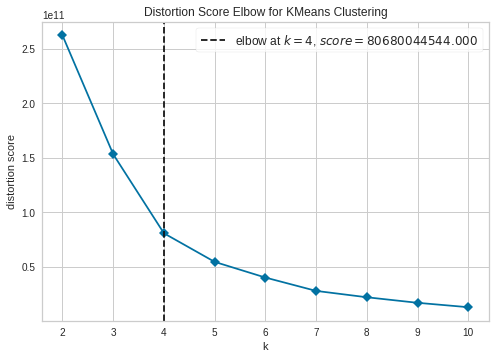

In [ ]:
# plot the elbow plot to confirm 4 is recommended
plot_model(kmeans, plot='elbow')


In [ ]:
rfm_df = assign_model(best_model)
rfm_df

,recency,frequency,monetary,Cluster
CustomerID,,,,
11000,270,8,8248.9900,Cluster 2
11001,49,11,6383.8800,Cluster 2
11002,339,4,8114.0400,Cluster 2
11003,263,9,8139.2900,Cluster 2
11004,272,6,8196.0100,Cluster 2
...,...,...,...,...
30106,426,114,101203.5836,Cluster 3
30108,457,105,144602.5816,Cluster 3
30110,426,6,1625.2755,Cluster 0


In [ ]:
# assign the cluster number (starting from 0) to the RFM dataset
rfm_df.Cluster.value_counts()

Cluster 0    14330
Cluster 2     4353
Cluster 1       88
Cluster 3       80
Name: Cluster, dtype: int64

<AxesSubplot:xlabel='Cluster', ylabel='recency'>

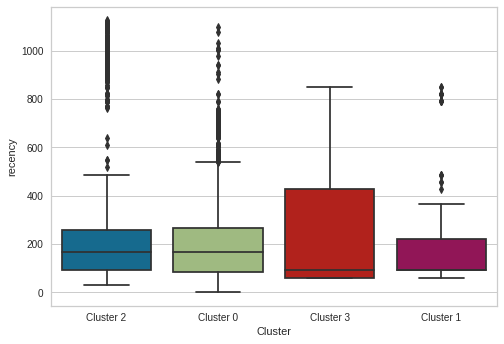

In [ ]:
# Clusters vs Recency
sns.boxplot('Cluster', 'recency', data=rfm_df)
# For recency, the lower the better. So the clusters are 3,1,0,2 accordingly

<AxesSubplot:xlabel='Cluster', ylabel='frequency'>

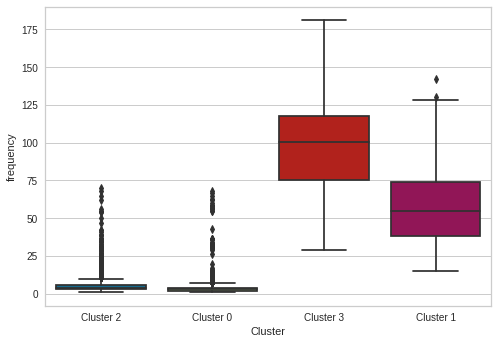

In [ ]:
# Clusters vs Frequency
sns.boxplot('Cluster', 'frequency', data=rfm_df)
#For frequency, the higher the better. So the cluster is 3,1,2,0

<AxesSubplot:xlabel='Cluster', ylabel='monetary'>

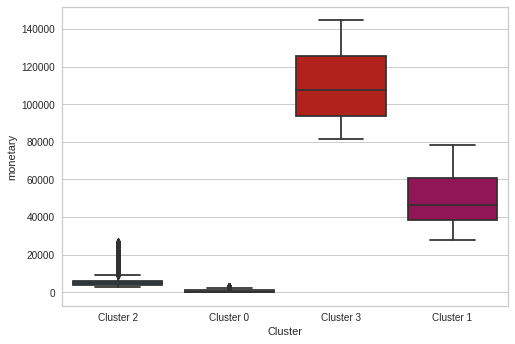

In [ ]:
# Clusters vs Monetary Value
sns.boxplot('Cluster', 'monetary', data=rfm_df)
#For monetary, the higher the better. So the cluster is 3,1,2,0 accordingly

In [ ]:
# reset the index so the CustomerID becomes a column
rfm_df = assign_model(best_model)
rfm_df

,recency,frequency,monetary,Cluster
CustomerID,,,,
11000,270,8,8248.9900,Cluster 2
11001,49,11,6383.8800,Cluster 2
11002,339,4,8114.0400,Cluster 2
11003,263,9,8139.2900,Cluster 2
11004,272,6,8196.0100,Cluster 2
...,...,...,...,...
30106,426,114,101203.5836,Cluster 3
30108,457,105,144602.5816,Cluster 3
30110,426,6,1625.2755,Cluster 0


In [ ]:
rfm_df.reset_index(inplace=True)
rfm_df

,CustomerID,recency,frequency,monetary,Cluster
0,11000,270,8,8248.9900,Cluster 2
1,11001,49,11,6383.8800,Cluster 2
2,11002,339,4,8114.0400,Cluster 2
3,11003,263,9,8139.2900,Cluster 2
4,11004,272,6,8196.0100,Cluster 2
...,...,...,...,...,...
18846,30106,426,114,101203.5836,Cluster 3
18847,30108,457,105,144602.5816,Cluster 3
18848,30110,426,6,1625.2755,Cluster 0
18849,30114,121,30,11652.9911,Cluster 2


##calculate lifetime value per customer

In [ ]:
# calculate the average spend value per customer by taking monetary (total amount spent) / frequency (how many times spent)
rfm_df['average_spend_value']= rfm_df['monetary']/rfm_df['frequency']
rfm_df

,CustomerID,recency,frequency,monetary,Cluster,average_spend_value
0,11000,270,8,8248.9900,Cluster 2,1031.123750
1,11001,49,11,6383.8800,Cluster 2,580.352727
2,11002,339,4,8114.0400,Cluster 2,2028.510000
3,11003,263,9,8139.2900,Cluster 2,904.365556
4,11004,272,6,8196.0100,Cluster 2,1366.001667
...,...,...,...,...,...,...
18846,30106,426,114,101203.5836,Cluster 3,887.750733
18847,30108,457,105,144602.5816,Cluster 3,1377.167444
18848,30110,426,6,1625.2755,Cluster 0,270.879250
18849,30114,121,30,11652.9911,Cluster 2,388.433037


In [ ]:
# calculate the maximum number of days in the dataset
rfm_df.describe()


,CustomerID,recency,frequency,monetary,average_spend_value
count,18851.000000,18851.000000,18851.000000,18851.000000,18851.000000
mean,20447.282425,190.459339,4.106838,2366.388156,516.826149
std,5467.345974,149.985116,8.686692,8216.586379,708.196073
min,11000.000000,0.000000,1.000000,4.990000,3.140000
25%,15712.500000,85.000000,2.000000,54.980000,20.340545
50%,20435.000000,166.000000,3.000000,548.980000,140.740000
75%,25176.500000,264.000000,4.000000,2751.417500,839.879271
max,30115.000000,1126.000000,181.000000,144602.581600,6214.259000


In [ ]:
# calculate the maximum number of days in the dataset
max_no_days=max(df_sales_order['OrderDate'])-min(df_sales_order['OrderDate'])
max_no_days=max_no_days.days
max_no_days

1126

In [ ]:
# find out how long the company has been serving each customer: years of service
# max_no_days - recency
rfm_df['years_of_service']= (1126 - rfm_df['recency'])/365
rfm_df

,CustomerID,recency,frequency,monetary,Cluster,average_spend_value,years_of_service
0,11000,270,8,8248.9900,Cluster 2,1031.123750,2.345205
1,11001,49,11,6383.8800,Cluster 2,580.352727,2.950685
2,11002,339,4,8114.0400,Cluster 2,2028.510000,2.156164
3,11003,263,9,8139.2900,Cluster 2,904.365556,2.364384
4,11004,272,6,8196.0100,Cluster 2,1366.001667,2.339726
...,...,...,...,...,...,...,...
18846,30106,426,114,101203.5836,Cluster 3,887.750733,1.917808
18847,30108,457,105,144602.5816,Cluster 3,1377.167444,1.832877
18848,30110,426,6,1625.2755,Cluster 0,270.879250,1.917808
18849,30114,121,30,11652.9911,Cluster 2,388.433037,2.753425


In [ ]:
# calculate lifetime value
# average spend value * years of service
rfm_df['lifetime_value']= rfm_df['average_spend_value']*rfm_df['years_of_service']
rfm_df

,CustomerID,recency,frequency,monetary,Cluster,average_spend_value,years_of_service,lifetime_value
0,11000,270,8,8248.9900,Cluster 2,1031.123750,2.345205,2418.197068
1,11001,49,11,6383.8800,Cluster 2,580.352727,2.950685,1712.438047
2,11002,339,4,8114.0400,Cluster 2,2028.510000,2.156164,4373.801014
3,11003,263,9,8139.2900,Cluster 2,904.365556,2.364384,2138.267053
4,11004,272,6,8196.0100,Cluster 2,1366.001667,2.339726,3196.069653
...,...,...,...,...,...,...,...,...
18846,30106,426,114,101203.5836,Cluster 3,887.750733,1.917808,1702.535653
18847,30108,457,105,144602.5816,Cluster 3,1377.167444,1.832877,2524.178137
18848,30110,426,6,1625.2755,Cluster 0,270.879250,1.917808,519.494452
18849,30114,121,30,11652.9911,Cluster 2,388.433037,2.753425,1069.521101


##get in customer demographics

In [ ]:
# read in Sales vPersonDemographics to get Customer demographics
df_demographics = pd.read_excel(file_path, sheet_name="Sales vPersonDemographics")
df_demographics.head(2)


,BusinessEntityID,TotalPurchaseYTD,DateFirstPurchase,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,Occupation,HomeOwnerFlag,NumberCarsOwned
0,3058,19.20,2004-04-07,1979-05-07,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0
1,3246,557.49,2003-10-24,1975-11-07,S,25001-50000,F,0.0,0.0,Partial College,Clerical,0.0,1.0


In [ ]:
#merge to SalesCustomer to get CustomerID into Person Demographics
df_customer_demographics = df_demographics.merge(df_sales_customer,
                                     left_on='BusinessEntityID',
                                     right_on='PersonID')
                                   
df_customer_demographics.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19119 entries, 0 to 19118
Data columns (total 20 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   BusinessEntityID      19119 non-null  int64         
 1   TotalPurchaseYTD      19119 non-null  float64       
 2   DateFirstPurchase     18484 non-null  datetime64[ns]
 3   BirthDate             18484 non-null  datetime64[ns]
 4   MaritalStatus         18484 non-null  object        
 5   YearlyIncome          18484 non-null  object        
 6   Gender                18484 non-null  object        
 7   TotalChildren         18484 non-null  float64       
 8   NumberChildrenAtHome  18484 non-null  float64       
 9   Education             18484 non-null  object        
 10  Occupation            18484 non-null  object        
 11  HomeOwnerFlag         18484 non-null  float64       
 12  NumberCarsOwned       18484 non-null  float64       
 13  CustomerID      

In [ ]:
# merge customer demographics to RFM dataset by CustomerID
df_customer_rfm =df_customer_demographics.merge(rfm_df,how='right',on='CustomerID',suffixes=['_person_demo','_rfm'])
df_customer_rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18851 entries, 0 to 18850
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   BusinessEntityID      18851 non-null  int64         
 1   TotalPurchaseYTD      18851 non-null  float64       
 2   DateFirstPurchase     18409 non-null  datetime64[ns]
 3   BirthDate             18409 non-null  datetime64[ns]
 4   MaritalStatus         18409 non-null  object        
 5   YearlyIncome          18409 non-null  object        
 6   Gender                18409 non-null  object        
 7   TotalChildren         18409 non-null  float64       
 8   NumberChildrenAtHome  18409 non-null  float64       
 9   Education             18409 non-null  object        
 10  Occupation            18409 non-null  object        
 11  HomeOwnerFlag         18409 non-null  float64       
 12  NumberCarsOwned       18409 non-null  float64       
 13  CustomerID      

In [ ]:
df_customer_rfm.drop('StoreID',axis=1,inplace=True)
df_customer_rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18851 entries, 0 to 18850
Data columns (total 26 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   BusinessEntityID      18851 non-null  int64         
 1   TotalPurchaseYTD      18851 non-null  float64       
 2   DateFirstPurchase     18409 non-null  datetime64[ns]
 3   BirthDate             18409 non-null  datetime64[ns]
 4   MaritalStatus         18409 non-null  object        
 5   YearlyIncome          18409 non-null  object        
 6   Gender                18409 non-null  object        
 7   TotalChildren         18409 non-null  float64       
 8   NumberChildrenAtHome  18409 non-null  float64       
 9   Education             18409 non-null  object        
 10  Occupation            18409 non-null  object        
 11  HomeOwnerFlag         18409 non-null  float64       
 12  NumberCarsOwned       18409 non-null  float64       
 13  CustomerID      

In [ ]:
df_customer_rfm.dropna(inplace=True) 
df_customer_rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18409 entries, 0 to 18408
Data columns (total 26 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   BusinessEntityID      18409 non-null  int64         
 1   TotalPurchaseYTD      18409 non-null  float64       
 2   DateFirstPurchase     18409 non-null  datetime64[ns]
 3   BirthDate             18409 non-null  datetime64[ns]
 4   MaritalStatus         18409 non-null  object        
 5   YearlyIncome          18409 non-null  object        
 6   Gender                18409 non-null  object        
 7   TotalChildren         18409 non-null  float64       
 8   NumberChildrenAtHome  18409 non-null  float64       
 9   Education             18409 non-null  object        
 10  Occupation            18409 non-null  object        
 11  HomeOwnerFlag         18409 non-null  float64       
 12  NumberCarsOwned       18409 non-null  float64       
 13  CustomerID      

In [ ]:

df_customer_rfm.profile_report(explorative=True) 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##regression

In [ ]:
# run the prediction model
# since lifetime_value is a numeric variable
# we should be using regression

# import pycaret regression module
from pycaret.regression import *

#### setup model
# ignore_features: ignore the features that will cause problems (e.g. high cardinality or just identifier) or have high correlation to lifetime_value
# categorical_features: define features that are categories. The columns will go through one hot encoding
# numeric_features: define features that are numeric in nature
# ordinal_features: one/some feature/s may be ordinal, i.e. categorical but having ranking
# date_features: define date features
# test other setup options to see which one gives you the best results
model = setup(data=df_customer_rfm,
              target='lifetime_value',
              ignore_features=[ 'monetary','average_spend_value','years_of_service','recency','frequency','BusinessEntityID','CustomerID','ModifiedDate','AccountNumber','rowguid','TerritoryID','PersonID'],

              categorical_features=['MaritalStatus', 'YearlyIncome','Cluster','Gender','Occupation'],
              numeric_features=['TotalChildren','NumberChildrenAtHome','TotalPurchaseYTD','NumberCarsOwned','HomeOwnerFlag'                 ],
              ordinal_features={'Education':['Partial High School','High School','Partial College','Bachelors','Graduate Degree']},
              
              date_features=['BirthDate','DateFirstPurchase'],
           
              normalize=True,
              normalize_method='minmax',
              #transformation=True,
              #pca=True,
              #pca_components=5,
              #ignore_low_variance=True,
              #combine_rare_levels=True,
              #remove_multicollinearity=True,
              polynomial_features=True,
              polynomial_degree=3,
              trigonometry_features=True,
              #feature_interaction=True,
              silent=True,
              session_id=42
              )

,Description,Value
0,session_id,42
1,Target,lifetime_value
2,Original Data,"(18409, 26)"
3,Missing Values,False
4,Numeric Features,5
5,Categorical Features,6
6,Ordinal Features,True
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(12886, 66)"


In [ ]:
# compare models
# sort such that the model with the lowest MAPE is on top
compare_models(sort='MAPE', turbo=True)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
rf,Random Forest Regressor,202.1772,2.024405e+05,449.2113,0.9142,0.3454,0.2562,11.514
dt,Decision Tree Regressor,242.3885,3.432316e+05,585.4093,0.8544,0.4076,0.2776,0.206
et,Extra Trees Regressor,234.0245,2.514551e+05,500.5224,0.8933,0.4014,0.3363,11.538
lightgbm,Light Gradient Boosting Machine,247.3776,2.479605e+05,497.2408,0.8951,0.5964,0.6197,0.510
gbr,Gradient Boosting Regressor,303.2708,3.210353e+05,566.4104,0.8641,0.6960,0.8622,2.305
par,Passive Aggressive Regressor,661.0801,1.439594e+06,1198.6256,0.3925,1.4304,1.4914,0.175
ada,AdaBoost Regressor,579.4578,5.985859e+05,773.1699,0.7460,1.6893,6.1099,0.790
ridge,Ridge Regression,773.1035,1.144087e+06,1069.2236,0.5160,1.8427,7.0510,0.034
lr,Linear Regression,773.2829,1.144160e+06,1069.2599,0.5160,1.8436,7.0514,0.291
lasso,Lasso Regression,771.8590,1.142999e+06,1068.6858,0.5165,1.8406,7.0594,0.053


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=42, verbose=0, warm_start=False)

In [ ]:
# create the best model
best_model = create_model('rf')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,195.6881,193106.2569,439.4386,0.9158,0.3237,0.2428
1,202.8657,202751.6295,450.2795,0.9134,0.3447,0.2551
2,204.8570,178418.3857,422.3960,0.9279,0.3920,0.2509
3,206.1190,227021.1845,476.4674,0.9104,0.3550,0.2592
4,206.7552,184219.0345,429.2074,0.9294,0.3262,0.2361
5,212.3907,219863.0204,468.8955,0.9087,0.3344,0.2567
6,209.5936,235040.1136,484.8094,0.8924,0.3623,0.2794
7,203.9192,223013.3173,472.2429,0.9051,0.3361,0.2502
8,190.1473,200395.7723,447.6559,0.9121,0.3412,0.2752


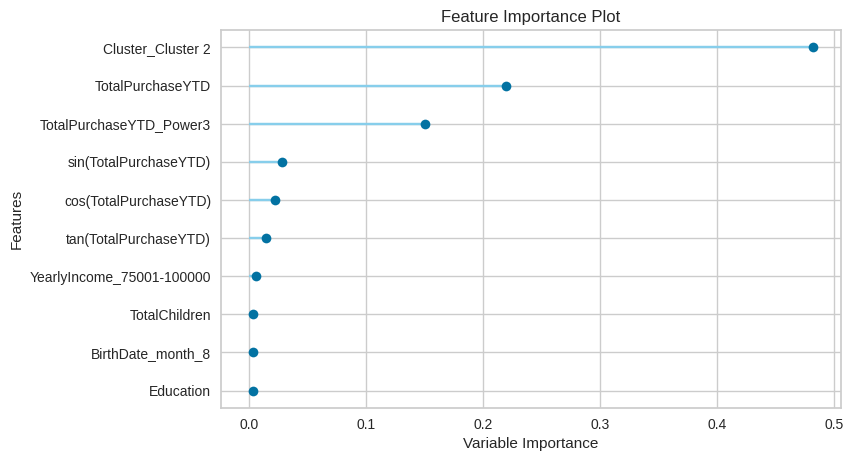

In [ ]:
plot_model(best_model, plot='feature')

In [ ]:
#save model
save_model(best_model, model_name='autovaluation_2022_08_03')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=['MaritalStatus',
                                                             'YearlyIncome',
                                                             'Cluster', 'Gender',
                                                             'Occupation'],
                                       display_types=False,
                                       features_todrop=['monetary',
                                                        'average_spend_value',
                                                        'years_of_service',
                                                        'recency', 'frequency',
                                                        'BusinessEntityID',
                                                        'CustomerID',
                                                        'ModifiedDate',
                                                       

In [ ]:
# since cluster 2 is the most important
# extract out cluster 2 customer demographics and compare to the biggest cluster (cluster 0)
cluster_2 = df_customer_rfm[df_customer_rfm.Cluster.str.startswith('Cluster 2')]
cluster_2.head()

,BusinessEntityID,TotalPurchaseYTD,DateFirstPurchase,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,...,AccountNumber,rowguid,ModifiedDate,recency,frequency,monetary,Cluster,average_spend_value,years_of_service,lifetime_value
0,13531,4751.05,2001-07-22,1966-04-08,M,75001-100000,M,2.0,0.0,Bachelors,...,AW00011000,477586B3-2977-4E54-B1A8-569AB2C7C4D4,2014-09-12 11:15:07,270,8,8248.99,Cluster 2,1031.123750,2.345205,2418.197068
1,5454,2955.92,2001-07-18,1965-05-14,S,50001-75000,M,3.0,3.0,Bachelors,...,AW00011001,C32A8084-9077-4F13-9738-1E2DA7C1DCD9,2014-09-12 11:15:07,49,11,6383.88,Cluster 2,580.352727,2.950685,1712.438047
2,11269,89.08,2001-07-10,1965-08-12,M,50001-75000,M,3.0,3.0,Bachelors,...,AW00011002,45715DD8-2F57-4A39-BEB4-6A8F99D59794,2014-09-12 11:15:07,339,4,8114.04,Cluster 2,2028.510000,2.156164,4373.801014
3,11358,4719.03,2001-07-01,1968-02-15,S,50001-75000,F,0.0,0.0,Bachelors,...,AW00011003,7E240EFC-7EE6-4814-93A8-269821157E18,2014-09-12 11:15:07,263,9,8139.29,Cluster 2,904.365556,2.364384,2138.267053
4,11901,4691.05,2001-07-26,1968-08-08,S,75001-100000,F,5.0,5.0,Bachelors,...,AW00011004,61CCB4D0-2328-4BBB-AEF9-E7E0B0FDD67A,2014-09-12 11:15:07,272,6,8196.01,Cluster 2,1366.001667,2.339726,3196.069653


In [ ]:
cluster_0 = df_customer_rfm[df_customer_rfm.Cluster.str.startswith('Cluster 0')]
cluster_0.head()

,BusinessEntityID,TotalPurchaseYTD,DateFirstPurchase,BirthDate,MaritalStatus,YearlyIncome,Gender,TotalChildren,NumberChildrenAtHome,Education,...,AccountNumber,rowguid,ModifiedDate,recency,frequency,monetary,Cluster,average_spend_value,years_of_service,lifetime_value
12,11663,8.99,2003-09-17,1968-01-18,M,75001-100000,F,2.0,0.0,Bachelors,...,AW00011012,2FC32AD9-A7E0-4505-9BA8-E5D2FB46AE4D,2014-09-12 11:15:07,105,5,81.26,Cluster 0,16.252000,2.797260,45.461074
13,13873,8.99,2003-10-15,1968-08-06,M,75001-100000,M,2.0,0.0,Bachelors,...,AW00011013,02D51F2D-A991-4C17-8139-B14D84C317AA,2014-09-12 11:15:07,7,5,113.96,Cluster 0,22.792000,3.065753,69.874652
14,2868,54.48,2003-09-24,1968-05-09,S,75001-100000,F,3.0,0.0,Bachelors,...,AW00011014,4272BECD-8F4F-4776-B45E-432967565198,2014-09-12 11:15:07,273,6,138.45,Cluster 0,23.075000,2.336986,53.925959
15,10963,2182.97,2003-07-22,1979-02-27,S,25001-50000,F,0.0,0.0,Partial College,...,AW00011015,F791BD74-EB82-4631-B9FC-F9FEE621FD13,2014-09-12 11:15:07,375,3,2500.97,Cluster 0,833.656667,2.057534,1715.277142
16,3800,2327.70,2003-08-13,1979-04-28,M,25001-50000,M,0.0,0.0,Partial College,...,AW00011016,023843CA-25FB-42BF-AC37-FAF6F4120DAC,2014-09-12 11:15:07,353,3,2332.28,Cluster 0,777.426667,2.117808,1646.440584


In [ ]:
# run pandas profiling on cluster 2
cluster_2.profile_report(explorative=True) 

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# run pandas profiling on cluster 0
cluster_0.profile_report(explorative=True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
cluster_2.describe()

,BusinessEntityID,TotalPurchaseYTD,TotalChildren,NumberChildrenAtHome,HomeOwnerFlag,NumberCarsOwned,CustomerID,PersonID,TerritoryID,recency,frequency,monetary,average_spend_value,years_of_service,lifetime_value
count,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000,4168.000000
mean,11591.121881,546.284942,1.677543,1.011276,0.701296,1.455134,17908.159069,11591.121881,6.838772,221.170345,4.363484,5027.952865,1401.891789,2.478985,3165.038887
std,5442.513756,2399.713727,1.513607,1.567341,0.457745,1.201312,5456.137364,5442.513756,2.895245,215.043631,2.117517,1511.844350,745.528528,0.589161,1375.137267
min,1701.000000,-3578.270000,0.000000,0.000000,0.000000,0.000000,11000.000000,1701.000000,1.000000,31.000000,1.000000,2951.052500,379.736820,0.000000,0.000000
25%,6748.250000,-1249.795000,0.000000,0.000000,0.000000,0.000000,13366.750000,6748.250000,4.000000,94.000000,3.000000,3896.532500,905.698625,2.375342,2226.797673
50%,11783.500000,707.360000,1.000000,0.000000,1.000000,1.000000,16402.000000,11783.500000,8.000000,168.500000,4.000000,4660.702500,1180.728000,2.623288,2894.729096
75%,16365.250000,2324.993950,3.000000,2.000000,1.000000,2.000000,21568.250000,16365.250000,9.000000,259.000000,5.000000,5976.740000,1577.916667,2.827397,3928.306461
max,20772.000000,9650.760000,5.000000,5.000000,1.000000,4.000000,29481.000000,20772.000000,10.000000,1126.000000,25.000000,13295.380000,3578.270000,3.000000,8919.007233


In [ ]:
cluster_0.describe()

,BusinessEntityID,TotalPurchaseYTD,TotalChildren,NumberChildrenAtHome,HomeOwnerFlag,NumberCarsOwned,CustomerID,PersonID,TerritoryID,recency,frequency,monetary,average_spend_value,years_of_service,lifetime_value
count,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000,14241.000000
mean,11518.692297,233.394034,1.893547,1.003090,0.669686,1.515835,20900.120778,11518.692297,5.617794,180.024507,2.958781,589.978873,247.864734,2.591714,607.282785
std,5310.954260,820.371540,1.637058,1.509703,0.470343,1.118683,5103.819116,5310.954260,3.053648,117.463271,2.670201,845.656895,429.355134,0.321817,1002.331820
min,1699.000000,-2443.350000,0.000000,0.000000,0.000000,0.000000,11012.000000,1699.000000,1.000000,0.000000,1.000000,4.990000,3.140000,0.079452,6.589699
25%,6965.000000,-21.980000,0.000000,0.000000,0.000000,1.000000,16798.000000,6965.000000,4.000000,83.000000,2.000000,39.470000,17.821667,2.361644,45.862877
50%,11485.000000,15.490000,2.000000,0.000000,1.000000,2.000000,21212.000000,11485.000000,6.000000,167.000000,3.000000,86.950000,29.490000,2.627397,77.077973
75%,16081.000000,503.980000,3.000000,2.000000,1.000000,2.000000,25252.000000,16081.000000,8.000000,264.000000,4.000000,839.480000,345.042000,2.857534,866.682000
max,20777.000000,2560.930000,5.000000,5.000000,1.000000,4.000000,29483.000000,20777.000000,10.000000,1097.000000,68.000000,2935.369600,2443.350000,3.084932,7296.579452


In [ ]:
#### Comparison of Cluster 2 to Cluster 0

# 2.34 times TotalPurchaseYTD compared to cluster 0
# The highest YearlyIncome in cluster 2 is 50-75k while cluster 0 is 25-50k 
# Cluster 2(34.33%) has higher % of bachelors compared to cluster 0 (27.47%)
# 1.47 times the frequency compared to cluster 0
# 8.52 times the monetary compared to cluster 0
# 5.21 times lifetime value compared to cluster 0
#Cluster 2 had strong purchase power compare to cluster 0

##Conclusion
#Based on these results, we can recommend that Adventure Works Cycles might be targeting marketing campaigns towards Customers in Cluster 2. 
#Alternatively, Adventure Works Cycles may be interested in targeting their marketing efforts on Cluster 0 to drive sales across other cluster.
